### **Introduction**

This notebook contains an exercise in the prediction of the stock market share price. We will be using 10 years of data for Singtel's share price in predicting its future movement. 

For our machine learning we will be using 2 libraries which are derived from a technique called Gradient Boosting [more here](https://machinelearningmastery.com/gentle-introduction-gradient-boosting-algorithm-machine-learning/);
 
1. XGBRegressor from XGBoost 
2. LightGBM from Microsoft 

For our features we will be making use of a number of technical indicators such as moving averages, RSI, MACD  which contribute towards the movement in share prices, [you can find more details here regarding their definition here](https://www.investopedia.com/technical-analysis-4689657).

## Setting up the notebook environment


### Installation

In [5]:
# Time series decomposition
!pip install stldecompose

# Shap explainability
!pip install shap

!pip install pandas-datareader
!pip install yfinance
!pip install fastapi
!pip install colabcode

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 564 kB 4.3 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 62 kB 1.1 MB/s 
     |████████████████████████████████| 6.4 MB 8.9 MB/s 
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
  Attempting uninstall: lxml
    Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is th

### Import

In [1]:
import os

# Data processing libraries
import numpy as np
import pandas as pd

# Predive modeling related libraries
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
import lightgbm as lgb

#Model explainability
import shap
from xgboost import plot_tree
from lightgbm import plot_importance

# Data visualization related package imports
import matplotlib.pyplot as plt
import plotly as py
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from IPython.display import HTML

# Disable sklearn warnings
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=DeprecationWarning)

# Accuracy evaluaters
import sklearn.metrics as sm

from stldecompose import decompose

# Show charts when running kernel
init_notebook_mode(connected=True)

# Change default background color for all visualizations
layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(250,250,250,0.8)')
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

import yfinance as yf
from pandas_datareader import data as pdr
from pydantic import BaseModel
from fastapi import FastAPI
import pickle

## Ingesting our data

We are going to use the yfinance library to retrieve our data from Yahoo finance. In addition to the financial data, it also provides useful methods for other information regarding the company as demonstrated below.

*There are other libraries which can be used for this purpose, but this library seems to be stable, has adoption (judging from github activity) and meets our needs and so we have chosen to go with this one.*

In [2]:
singtel = yf.Ticker("Z74.SI")

# get stock info
singtel.info

{'52WeekChange': 0.081545115,
 'SandP52WeekChange': -0.08326143,
 'address1': '31 Exeter Road',
 'address2': 'No. 19-00 Comcentre',
 'algorithm': None,
 'annualHoldingsTurnover': None,
 'annualReportExpenseRatio': None,
 'ask': 2.55,
 'askSize': 0,
 'averageDailyVolume10Day': 36908326,
 'averageVolume': 32175043,
 'averageVolume10days': 36908326,
 'beta': None,
 'beta3Year': None,
 'bid': 2.56,
 'bidSize': 0,
 'bookValue': 1.702,
 'category': None,
 'circulatingSupply': None,
 'city': 'Singapore',
 'companyOfficers': [],
 'country': 'Singapore',
 'currency': 'SGD',
 'currentPrice': 2.54,
 'currentRatio': 0.898,
 'dateShortInterest': None,
 'dayHigh': 2.56,
 'dayLow': 2.5,
 'debtToEquity': 42.223,
 'dividendRate': 0.1,
 'dividendYield': 0.0356,
 'earningsGrowth': None,
 'earningsQuarterlyGrowth': None,
 'ebitda': 3342400000,
 'ebitdaMargins': 0.21790001,
 'enterpriseToEbitda': 16.252,
 'enterpriseToRevenue': 3.541,
 'enterpriseValue': 54320488448,
 'exDividendDate': 1639699200,
 'exchan

In [3]:
singtel

yfinance.Ticker object <Z74.SI>

In [4]:
# show major share holder information
singtel.major_holders

,0,1
0,6.10%,% of Shares Held by All Insider
1,64.35%,% of Shares Held by Institutions
2,68.53%,% of Float Held by Institutions
3,376,Number of Institutions Holding Shares


Visualizing the data is an important aspect of solving data science problem which provides insights into the data distributions and identify patterns. We are using yfinance python package to retrieve the data for the specific period of time.

In [5]:
#df = pd.read_csv('singtel.csv', sep=',')
# df = pdr.get_data_yahoo("Z74.SI", start="2010-01-01", end="2018-12-31")
df = yf.download("Z74.SI", start="2010-01-01", end="2022-06-12")
df['Date'] = df.index
df['Date'] = pd.to_datetime(df['Date'])
df.index = range(len(df))

df.head()

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,Date
0,3.11,3.13,3.09,3.13,1.787839,11659000,2010-01-04
1,3.16,3.16,3.08,3.12,1.782127,25150000,2010-01-05
2,3.11,3.14,3.09,3.10,1.770703,13382000,2010-01-06
3,3.10,3.11,3.01,3.03,1.730720,26989000,2010-01-07
4,3.04,3.05,3.01,3.05,1.742144,17903000,2010-01-08


### Data Visualization




#### OHLC (open/high\/low\/close) Chart

OHLC chart visualize how share price traded each day with open, high ,low and close values. This chart provide overview on how momentum or volatility of stock changed over the time. Sample points where the close value is higher than the open value are drawn in green whereas decreasing are drawn in red.

In [6]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(go.Ohlc(x=df.Date,
                      open=df.Open,
                      high=df.High,
                      low=df.Low,
                      close=df.Close,
                      name='Price'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.Date, y=df.Volume, name='Volume'), row=2, col=1)

HTML(fig.to_html())

#### Volume Chart

Volume of share price data indicates the daily number of shares traded over a selected period. Volume is very important component becase it provide how volume impact on the stock price.

In [7]:
fig = go.Figure(go.Bar(x=df.Date, y=df.Volume, name='Volume', marker_color='red'))
HTML(fig.to_html())

#### Time Series Decomposition

Stock market price predication contains time series data which shows the price variation over the time. Time series data can be decompose into Trend, Seasonal and Noise components which can be use as features. Combining these component will align with the final stock price variation. 

$y(t) = Trend + Seasonality + Noise$

Decomposition provides insights of the time series data on how these components can be best captured in a given model. It's very important to focus on demposed components at data preparation, model selection, and model tuning. Here we are showing how it can be achieved with existing python library.

Please refer this [article](https://machinelearningmastery.com/decompose-time-series-data-trend-seasonality/) for more information.

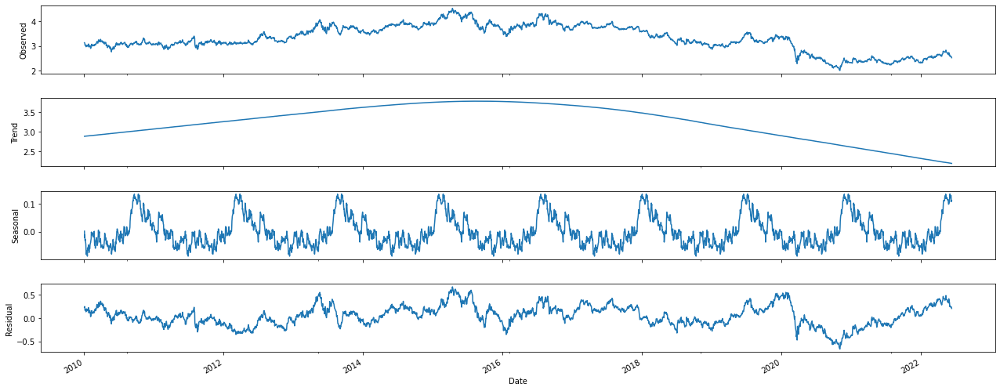

In [8]:
df_close = df[['Date', 'Close']].copy()
df_close = df_close.set_index('Date')
df_close.head()

decomp = decompose(df_close, period=365)
fig = decomp.plot()
fig.set_size_inches(20, 8)

## Data Preprocessing

Data preprocessing is an important phase of solving data science problem which targeted on preparing the data to build the prediction models. 

Outliers which known as noisy or out of range values should be replaced or removed. Here, we are replacing outliers with the mean.

*Exercise:* 

*(1) What are some other ways that you can achieve the below? Hint: lookup numpy.where*

*(2) What are some other ways of detecting and treating outliers? Implement them here Hint: IQR, ZScore*

### Outlier detection and removal

In [9]:
#Average of the volume excluding outliers
mean = df.loc[df['Volume'] < 100000000, 'Volume'].mean()

#Replace the outliers with mean value
df.loc[df.Volume > 100000000, 'Volume'] = np.nan
df.fillna(mean, inplace=True)

fig = go.Figure(go.Bar(x=df.Date, y=df.Volume, name='Volume', marker_color='red'))
HTML(fig.to_html())

In [ ]:
# Fill empty values with forward fill
df.ffill(axis = 0, inplace=True)
df.head()

,Open,High,Low,Close,Adj Close,Volume,Date
0,3.11,3.13,3.09,3.13,1.821572,11659000.0,2010-01-04
1,3.16,3.16,3.08,3.12,1.815752,25150000.0,2010-01-05
2,3.11,3.14,3.09,3.10,1.804113,13382000.0,2010-01-06
3,3.10,3.11,3.01,3.03,1.763374,26989000.0,2010-01-07
4,3.04,3.05,3.01,3.05,1.775014,17903000.0,2010-01-08


### Feature Engineering

Feature engineering is associate with working on features which are relevant for the target prediction. We are predicting the closing stock price of the given dataset. Hence, it's very important to identify and derive necessary features required for the stock price prediction task. As stated above, technical indicators are very important in predicting the stock price. These technical indicators are derived from the existing data which will be added as new features.

There are lot of important characteristics of the stock price such as trend or momentum help you to predict future prices. These technical indicators useful in improving the accuracy of the prediction.

##### Moving Averages

Moving averages of the closing stock price is useful in predicting the future stock prices as it indicate how stock priced varied within selected time interval eg 5 last 5, 10, 15 and 30 days. As daily stock price over the time can be fluctuated rapidly, moving averages help to smooth out stock prices on a chart by filtering out short-term price fluctuations. There are two (most common) averages used in technical analysis which are:

Simple Moving Average (SMA) - a simple average calculated over last N days e.g. 50, 100 or 200,
Exponential Moving Average (EMA) - an average where greater weights are applied to recent prices. We are deriving new features based on moving averages and name them as $SMA_{5}$, $SMA_{10}$, $SMA_{15}$, $SMA_{30}$ and $EMA_{9}$.

Plotting these features shows how they have helped to smooth out the noisy curves.

In [ ]:
df['EMA_9'] = df['Close'].ewm(9).mean().shift()
df['SMA_5'] = df['Close'].rolling(5).mean().shift()
df['SMA_10'] = df['Close'].rolling(10).mean().shift()
df['SMA_15'] = df['Close'].rolling(15).mean().shift()
df['SMA_30'] = df['Close'].rolling(30).mean().shift()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df.Date, y=df.EMA_9, name='EMA 9'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_5, name='SMA 5'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_10, name='SMA 10'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_15, name='SMA 15'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_30, name='SMA 30'))
fig.add_trace(go.Scatter(x=df.Date, y=df.Close, name='Close', opacity=0.2))
HTML(fig.to_html())

#### Relative Strength Index

Relative Strength Index (RSI) is another important indicator to predict stock price where it indicates the magnitude of recent price changes. It provides insights on whether a stock is either overbought or oversold. Typically RSI range from 0 to 100 and value greater or equal than 70 signal that a stock is becoming overbought/overvalued, meanwhile value less than or equal 30 indicate that it is oversold. Full range of RSI is from 0 to 100.

We have added RSI as feature to predict the stock price.

In [ ]:
def relative_strength_idx(df, n=14):
    close = df['Close']
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi

df['RSI'] = relative_strength_idx(df).fillna(0)

fig = go.Figure(go.Scatter(x=df.Date, y=df.RSI, name='RSI'))
HTML(fig.to_html())

#### Moving Average Convergence Divergence (MACD) 

MACD is an indicator which shows the relationship between two exponential moving averages i.e. 12-day and 26-day EMAs. We have obtain MACD by subtracting 26-day EMA (known as slow EMA) from the 12-day EMA (known as fast EMA).

More information can be found [here](https://www.investopedia.com/terms/m/macd.asp).

In [ ]:
EMA_12 = pd.Series(df['Close'].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(df['Close'].ewm(span=26, min_periods=26).mean())
df['MACD'] = pd.Series(EMA_12 - EMA_26)
df['MACD_signal'] = pd.Series(df.MACD.ewm(span=9, min_periods=9).mean())

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=df.Date, y=df.Close, name='Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=EMA_12, name='EMA 12'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=EMA_26, name='EMA 26'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=df['MACD'], name='MACD'), row=2, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=df['MACD_signal'], name='Signal line'), row=2, col=1)
HTML(fig.to_html())

### Preparing data for prediction

Since we are looking to predict share price for the following day we will shift the closing share price by 1 which replaces the current value with the next day's share price.

In [ ]:
df['Close'] = df['Close'].shift(-1)

In [ ]:
df[:35]

,Open,High,Low,Close,Adj Close,Volume,Date,EMA_9,SMA_5,SMA_10,SMA_15,SMA_30,RSI,MACD,MACD_signal
0,3.11,3.13,3.09,3.12,1.821572,11659000.0,2010-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3.16,3.16,3.08,3.10,1.815752,25150000.0,2010-01-05,3.130000,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
2,3.11,3.14,3.09,3.03,1.804113,13382000.0,2010-01-06,3.124737,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
3,3.10,3.11,3.01,3.05,1.763374,26989000.0,2010-01-07,3.115609,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
4,3.04,3.05,3.01,3.02,1.775014,17903000.0,2010-01-08,3.090715,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
5,3.06,3.06,3.02,2.97,1.757555,21861000.0,2010-01-11,3.080773,3.086,NaN,NaN,NaN,0.000000,NaN,NaN
6,3.02,3.03,2.97,2.97,1.728456,42581000.0,2010-01-12,3.067803,3.064,NaN,NaN,NaN,0.000000,NaN,NaN
7,2.96,2.98,2.95,3.02,1.728456,19207000.0,2010-01-13,3.049056,3.034,NaN,NaN,NaN,0.000000,NaN,NaN
8,2.98,3.06,2.98,3.01,1.757555,24858000.0,2010-01-14,3.035175,3.008,NaN,NaN,NaN,0.000000,NaN,NaN
9,3.04,3.05,3.01,3.02,1.751735,10979000.0,2010-01-15,3.032698,3.006,NaN,NaN,NaN,0.000000,NaN,NaN


#### Drop invalid samples

MACD_signal feature is calculated based on SMA12 and SMA12 features with span of 9. Hense we have filtered out the first 33 rows where the MACD_signal feature is empty.

In [ ]:
df = df.iloc[33:] # Because of moving averages and MACD line
df = df[:-1]      # Because of shifting close price

df.index = range(len(df))

#### Allocate data for training, validation and testing

In any prediction problem, it's very important to have Train, Validation and Test datasets. Training dataset used to train the model while validation dataset used to test the accuracy of the model. Test dataset use to evaluate the accuracy of the final model.

In time series data, selecting these three splits can't be done in random order. It has to follow time divided approach as shown in the below figure.
Here we have split stock data frame into three subsets: training set consists of ($70\%$) data, validation set consist of ($15\%$) data and test set consists of ($15\%$) data. These splits are assigned to three data frames named train_df, valid_df, test_df. All three frames have been plotted in the figure below.

In [ ]:
test_size  = 0.15
valid_size = 0.15

test_split_idx  = int(df.shape[0] * (1-test_size))
valid_split_idx = int(df.shape[0] * (1-(valid_size+test_size)))

train_df  = df.loc[:valid_split_idx].copy()
valid_df  = df.loc[valid_split_idx+1:test_split_idx].copy()
test_df   = df.loc[test_split_idx+1:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.Date, y=train_df.Close, name='Training'))
fig.add_trace(go.Scatter(x=valid_df.Date, y=valid_df.Close, name='Validation'))
fig.add_trace(go.Scatter(x=test_df.Date,  y=test_df.Close,  name='Test'))
HTML(fig.to_html())

#### Remove unused features

We have derived the features we are going to use to predict the closing stock price, thereby we are removing all other columns.

In [ ]:
drop_cols = ['Date', 'Volume', 'Open', 'Low', 'High', 'Adj Close']

train_df = train_df.drop(drop_cols, 1)
valid_df = valid_df.drop(drop_cols, 1)
test_df  = test_df.drop(drop_cols, 1)

#### Setup dataframes

Separate the closing stock price and the the features into dataframes for use with our algorithms. We can see the features being used for training namely; $SMA_{5}$, $SMA_{10}$, $SMA_{15}$, $SMA_{30}$, $EMA_{9}, ***MACD*** and ***MACD_signal***.

In [ ]:
y_train = train_df['Close'].copy()
X_train = train_df.drop(['Close'], 1)

y_valid = valid_df['Close'].copy()
X_valid = valid_df.drop(['Close'], 1)

y_test  = test_df['Close'].copy()
X_test  = test_df.drop(['Close'], 1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1556 entries, 0 to 1555
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   EMA_9        1556 non-null   float64
 1   SMA_5        1556 non-null   float64
 2   SMA_10       1556 non-null   float64
 3   SMA_15       1556 non-null   float64
 4   SMA_30       1556 non-null   float64
 5   RSI          1556 non-null   float64
 6   MACD         1556 non-null   float64
 7   MACD_signal  1556 non-null   float64
dtypes: float64(8)
memory usage: 97.4 KB


## **Building the predictive model**

### Predicting with XGBoost

- Builds on the foundations of gradient boosted trees and decision tree ensembles, based on the intuition of combining weak learners and their conclusions to build a stronger model
- Widely used in industry and machine learning competitions ([this resource](https://github.com/dmlc/xgboost/tree/master/demo#machine-learning-challenge-winning-solutions) shows winners of data science competitions using XGBoost)
- Known for its execution speed and its model performance
<br>
<br>
<img src='https://drive.google.com/uc?id=1LzsPvzhKpoG2j86LwemMLWtOeSeQEdph' width='80%' border='black'>

There are a lot of resources available which explain the workings of XGBoost and its implementation. Some references as an example at [here](https://xgboost.readthedocs.io/en/latest/tutorials/model.html)
[here](https://machinelearningmastery.com/gentle-introduction-xgboost-applied-machine-learning/) and [here](https://towardsdatascience.com/https-medium-com-vishalmorde-xgboost-algorithm-long-she-may-rein-edd9f99be63d)

In [ ]:
model_xgb = xgb.XGBRegressor(n_estimators=120, learning_rate=0.01, max_depth=12, gamma=0.02, objective='reg:squarederror')
model_xgb.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.02,
             importance_type='gain', learning_rate=0.01, max_delta_step=0,
             max_depth=12, min_child_weight=1, missing=None, n_estimators=120,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1)

### Predicting with LightGBM

LightGBM stands for *Light Gradient Boosting Machine* originates from Microsoft and varies in the way that it creates trees, leaf wise compared to XGBoost which does it level wise. This allows for efficient performance and has been known to be up to 5 to 6 times faster than XGBoost.

Again there are a lot of resources available, for example [here](https://medium.com/@pushkarmandot/https-medium-com-pushkarmandot-what-is-lightgbm-how-to-implement-it-how-to-fine-tune-the-parameters-60347819b7fc) and [here](https://towardsdatascience.com/what-makes-lightgbm-lightning-fast-a27cf0d9785e)

In [ ]:
model_lgbm = lgb.LGBMRegressor(objective='regression', learning_rate=0.01, max_depth=12, n_estimators=120)
model_lgbm.fit(X_train, y_train)

LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.01, max_depth=12,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=120, n_jobs=-1, num_leaves=31,
              objective='regression', random_state=None, reg_alpha=0.0,
              reg_lambda=0.0, silent=True, subsample=1.0,
              subsample_for_bin=200000, subsample_freq=0)

### Comparisons

Some comparison between these two algorithms can be found [here](https://towardsdatascience.com/lightgbm-vs-xgboost-which-algorithm-win-the-race-1ff7dd4917d) and [here](https://towardsdatascience.com/catboost-vs-light-gbm-vs-xgboost-5f93620723db#:~:text=Structural%20Differences%20in%20LightGBM%20%26%20XGBoost,Here%20instances%20mean%20observations%2Fsamples.)

There are also other similar algorithms such as [CatBoost](https://catboost.ai/) built by [Yandex](https://yandex.com/) which are used in industry.

All these models are open source and can be found on Github.

## **Evaluating the performance of our models**

When selecting the best performing model, it's very important to evaluate the accuracy of the trained models. There are several performance evaluation metrices. Regression problems known as predicting continuous variable have different set of performance evaluation metrices compared to classification models which predicts boolean value. We are using Mean Absolute Error, Mean Squared Error, Median Absolute Error, Variance and R2 score to compare both of the models.

More information on evaluation metrices which in built on scikit-learn python package can be found in [here](https://scikit-learn.org/stable/modules/model_evaluation.html).

Some explanations regarding the use of these metrics can be found [here](https://machinelearningmastery.com/regression-metrics-for-machine-learning/).

In [ ]:
print("Performance statistics - XGBoost Model")
y_test_pred = model_xgb.predict(X_test)

print("Mean absolute error (MAE) =", round(sm.mean_absolute_error(y_test, y_test_pred), 2)) 
print("Root Mean squared error (RMSE) =", round(sm.mean_squared_error(y_test, y_test_pred, squared=False), 2)) 
print("Median absolute error =", round(sm.median_absolute_error(y_test, y_test_pred), 2)) 
print("Explain variance score =", round(sm.explained_variance_score(y_test, y_test_pred), 2)) 
print("R2 score =", round(sm.r2_score(y_test, y_test_pred), 2))

Performance statistics - XGBoost Model
Mean absolute error (MAE) = 0.85
Root Mean squared error (RMSE) = 0.86
Median absolute error = 0.86
Explain variance score = 0.88
R2 score = -11.51


In [ ]:
print("Performance statistics - LightGBM Model")
y_test_pred = model_lgbm.predict(X_test)

print("Mean absolute error (MAE) =", round(sm.mean_absolute_error(y_test, y_test_pred), 2)) 
print("Mean squared error (RMSE) =", round(sm.mean_squared_error(y_test, y_test_pred, squared=False), 2)) 
print("Median absolute error =", round(sm.median_absolute_error(y_test, y_test_pred), 2)) 
print("Explain variance score =", round(sm.explained_variance_score(y_test, y_test_pred), 2)) 
print("R2 score =", round(sm.r2_score(y_test, y_test_pred), 2))

Performance statistics - LightGBM Model
Mean absolute error (MAE) = 0.08
Mean squared error (RMSE) = 0.09
Median absolute error = 0.07
Explain variance score = 0.89
R2 score = 0.85


Going by the comparative metrics, LightGBM seems to be performing well. But can we do better? The answer is yes, we can tune the parameters of the model to provide better performance.

### Finding the best parameters

Most machine learning models expose what are known are as hyper parameters. These parameters allow the practitioner to tune the model to obtain better performance. 

For example, tree based algorithms will have number of tree depth and number of trees as tunable parameters. 

Grid search is a well known approach to search for optimized parameters from given set of values for each tunable parameter. Below we are utilising Grid Search to ascertain optimal hyper parameter settings for the LightGBM model.

In [ ]:
parameters = {
    'n_estimators': [120, 200],
    'learning_rate': [0.01, 0.05],
    'max_depth': [10, 12],
}


eval_set = [(X_train, y_train), (X_valid, y_valid)]
model = lgb.LGBMRegressor(eval_set=eval_set, objective='regression', verbose=0)
clf = GridSearchCV(model, parameters)

clf.fit(X_train, y_train)

print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

Best params: {'learning_rate': 0.05, 'max_depth': 12, 'n_estimators': 120}
Best validation score = 0.585802163305276


In [ ]:
model = lgb.LGBMRegressor(**clf.best_params_, objective='regression')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)
y_test_pred = model.predict(X_test)

print("Mean absolute error =", round(sm.mean_absolute_error(y_test, y_test_pred), 2)) 
print("Mean squared error =", round(sm.mean_squared_error(y_test, y_test_pred), 2)) 
print("Median absolute error =", round(sm.median_absolute_error(y_test, y_test_pred), 2)) 
print("Explain variance score =", round(sm.explained_variance_score(y_test, y_test_pred), 2)) 
print("R2 score =", round(sm.r2_score(y_test, y_test_pred), 2))

Mean absolute error = 0.04
Mean squared error = 0.0
Median absolute error = 0.03
Explain variance score = 0.95
R2 score = 0.95


### Calculate and visualize predictions

After selecting the best performing model, we are going to predict and visualize the predictions to get an understanding about the model performance. 

In [ ]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')

y_true = [3.66000009 3.68000007 3.69000006 3.67000008 3.68000007]
y_pred = [3.69388783 3.63635509 3.6298859  3.67183445 3.6621615 ]


In [ ]:
predicted_prices = df.loc[test_split_idx+1:].copy()
predicted_prices['Close'] = y_pred

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=df.Date, y=df.Close,
                         name='Truth',
                         marker_color='LightSkyBlue'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=predicted_prices.Close,
                         name='Prediction',
                         marker_color='MediumPurple'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_test,
                         name='Truth',
                         marker_color='LightSkyBlue',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_pred,
                         name='Prediction',
                         marker_color='MediumPurple',
                         showlegend=False), row=2, col=1)

HTML(fig.to_html())

## **Model Deployment**

Now that we have developed a model, the next step is to expose it for use. Here we look at a way we can expose the model through a RESTful API so that it can be consumed.

We will be using the 'fastapi' and 'colabcode' to expose our stock prediction model as an API.

### Persist the model
We will first 'persist' our model to a portable format so that it can be stored and shared across environments and execution sessions. We will be using a popular library 'pickle' to achieve this.

In [ ]:
Pkl_Filename = 'test.pkl'
with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(model, file)

### Define the data contract
We will then define a data contract in Python by which we can pass parameters through to our API. 

In [ ]:
class Stock(BaseModel):
    EMA_9: float 
    SMA_5: float 
    SMA_10: float 
    SMA_15: float 
    SMA_30: float 
    RSI: float 
    MACD: float 
    MACD_signal: float 
    
    class Config:
        schema_extra = {
            "example": {
                "EMA_9": 3.006559, 
                "SMA_5": 3.024, 
                "SMA_10": 2.997,
                "SMA_15" : 3.000667,
                "SMA_30": 3.015000,
                "RSI": 50.00,
                "MACD": 0.000978,
                "MACD_signal": 0.035007
            }
        }

### Define the API
We will then define an service API by which we can expose the model for external use.

In [ ]:
app = FastAPI()

@app.on_event("startup")
def load_model():
    global model
    model = pickle.load(open("test.pkl", "rb"))

@app.get('/')
def index():
    return {'message': 'This is the homepage of the API '}


@app.post('/predict')
def get_stock_price(data: Stock):
    received = data.dict()
    EMA_9 = received['EMA_9'] 
    SMA_5 = received['SMA_5'] 
    SMA_10 = received['SMA_10'] 
    SMA_15 = received['SMA_15'] 
    SMA_30 = received['SMA_30'] 
    RSI = received['RSI'] 
    MACD =  received['MACD'] 
    MACD_signal = received['MACD_signal']
    pred_val = model.predict([[EMA_9, SMA_5, SMA_10,
                                SMA_15, SMA_30, RSI, MACD, MACD_signal]]).tolist()[0]
    return {'prediction': pred_val}

### Host the service API
We will finally make use of the 'colabcode' library to setup an environment in which our API can live and execute. Uses [ngrok](https://ngrok.com/) to provide a secure tunnel to the API.

In [ ]:
from colabcode import ColabCode
server = ColabCode(port=10000, code=False)

In [ ]:
# server.run_app(app=app)

Public URL: NgrokTunnel: "https://c5c0d3d105a0.ngrok.io" -> "http://localhost:10000"


INFO:     Started server process [238]
INFO:     Waiting for application startup.
INFO:     Application startup complete.
INFO:     Uvicorn running on http://127.0.0.1:10000 (Press CTRL+C to quit)


INFO:     131.172.30.176:0 - "GET / HTTP/1.1" 200 OK
INFO:     131.172.30.176:0 - "GET /favicon.ico HTTP/1.1" 404 Not Found
INFO:     203.219.219.132:0 - "GET / HTTP/1.1" 200 OK
INFO:     131.172.30.176:0 - "GET /docs HTTP/1.1" 200 OK
INFO:     131.172.30.176:0 - "GET /openapi.json HTTP/1.1" 200 OK
INFO:     203.219.219.134:0 - "GET /docs HTTP/1.1" 200 OK
INFO:     203.219.219.134:0 - "GET /openapi.json HTTP/1.1" 200 OK
INFO:     131.172.30.176:0 - "POST /predict HTTP/1.1" 200 OK
INFO:     34.74.155.79:0 - "POST /predict HTTP/1.1" 200 OK


INFO:     Shutting down
INFO:     Waiting for application shutdown.
INFO:     Application shutdown complete.
INFO:     Finished server process [238]


### Consume our service  - Testing

We can test the service by running a Curl command to invoke the API to get the model's prediction for tomorrow's price. As you can see the model is also passing through a set of parameters for technical indicators, however at our service we can also see that we have set defaults for each of these values. 

You will need to replace the url section before the /predict with the url given above. You can use a separate notebook and use ! to execute a shell command, or you can run it from your local machine.

```
!curl -X 'POST' 'https://c5c0d3d105a0.ngrok.io/predict' -H 'accept: application/json' \
  -H 'Content-Type: application/json' \
  -d '{"EMA_9": 3.006559,"SMA_5": 3.024,"SMA_10": 2.997,"SMA_15": 3.000667, "SMA_30": 3.015,"RSI": 50,"MACD": 0.000978,"MACD_signal": 0.035007}'
```

*Exercise:*

*(1) Derive the technical indicators and include them in your API. Hint: pull the data through and use functions*

*(2) How would you go about performing a 2 week forecast?*

## Rationalising / Explaining the model

Explainable Artificial Intelligence (XAI) refers to the capability of a machine learning model to describe and rationalize the predicted outputs in a way that can be understood by the humans. 

Machine learning models no longer can be treated as black boxes. Understanding the reasons behind the predicted outputs will provide more insights on which features are important towards the target predictions. As well as provide  both model developers and decision makers a platform to understand the factors that contribute most toward the results. 

This also provides a useful for the building of trust in the models being used especially among laymen stakeholders.

LightGBM provides built-in functions to understand feature importance which can be viewed as follow.

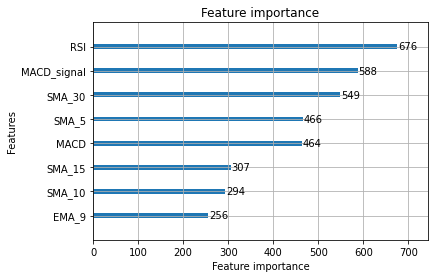

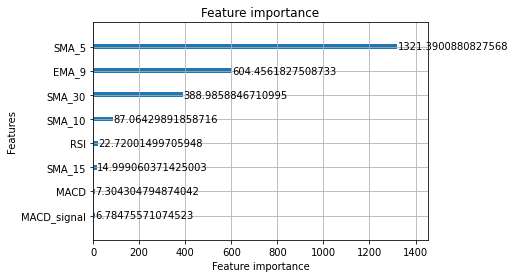

In [ ]:
plot_importance(model);
plot_importance(model, importance_type='gain');

*importance_type: indicates how the importance is calculated. If “split”, result contains numbers of times the feature is used in a model. If “gain”, result contains total gains of splits which use the feature.*

### SHAP

SHAP (SHapley Additive exPlanations) uses concepts from game theory to explain the outputs of a machine learning model. 

SHAP values are identified as a mathematically consistent way for getting feature importance, and they work particularly well with tree-based models. 

As a note calculating SHAP values are a resource intensive operation and they should be used judiciously.

More information: 

*   https://towardsdatascience.com/explain-your-model-with-the-shap-values-bc36aac4de3d
*   https://towardsdatascience.com/explain-any-models-with-the-shap-values-use-the-kernelexplainer-79de9464897a






#### Summary plots

Summary plot of SHAP values indicate how each feature is important towards the target prediction. As per the below plot, 5 day moving average(SMA_5) is the most impactful feature.

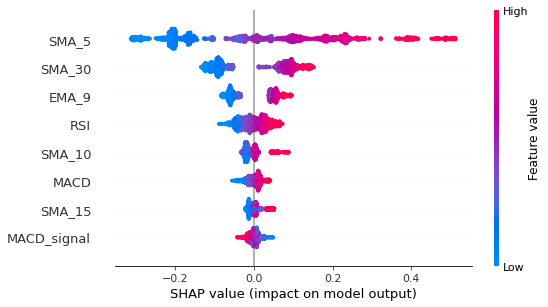

In [ ]:
# Create object that can calculate shap values
explainer = shap.TreeExplainer(model)

# Calculate Shap values
shap_values = explainer.shap_values(X_train)

shap.summary_plot(shap_values, X_train)

**Interpreting the plot**

**Feature importance**: Variables are ranked in descending order of the importance. SMA_5 is the most important feature towards the prediction.

**Impact**: The horizontal location of each feature indicate whether the effect of that value is associated with a higher or lower prediction.

**Color Scheme**: Color indicate whether that variable has positive impact (in red) or negative impact (in blue) for that observation.

**Correlation**: Higher values of SMA_5 has positive impact on the share price which indicate in red color and the “positive” impact is shown on the X-axis. Similarly, MACD_signal is negatively correlated with the target variable.

These values don't necessarily indicate a causality, rather they look at providing relative feature importance toward the prediction. If the feature has medium permutation importance, that could mean two things;

*   Large impact on fewer number of predictions but no much impact
*   Medium effect on all of the predictions



#### Dependence plots

The partial dependence plot shows the marginal effect of one or two variables towards the predicted outcome. It indicate the relationship between the target and the variable whether its linear, monotonic, or more complex. Below shows the dependence plot of SMA_5 variable. SHAP library automatically select the next feature EMA_9 which is mostly interact with selected feature. Below plot shows that there is a linear and positive trend between SMA_5 and the share price while SMA_5 interacts with EMA_9 frequently.

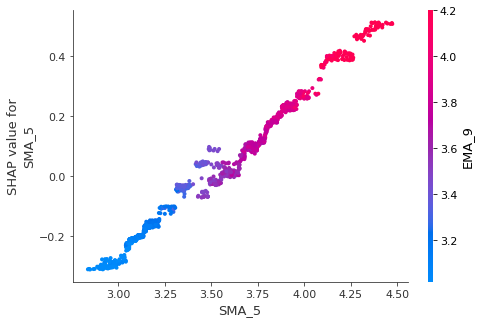

In [ ]:
shap.dependence_plot("SMA_5", shap_values, X_train)

#### Individual force plots

The individual force plot indicate how SHAP values impact for each of the prediction. Here we are selecting the first row which is the first day of the dataset to analyze how each feature impact towards the target prediction.


In [ ]:
# print the JS visualization code to the notebook
shap.initjs()

shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

In [ ]:
print("Row values")
print(X_train.iloc[0,:])
print("Actual Value")
print(y_train.iloc[0])
print("Mean values")
X_train.mean()

Row values
EMA_9           3.009471
SMA_5           3.028000
SMA_10          3.005000
SMA_15          3.001333
SMA_30          3.005000
RSI            51.063830
MACD            0.003224
MACD_signal     0.000695
Name: 0, dtype: float64
Actual Value
3.049999952316284
Mean values


EMA_9           3.496041
SMA_5           3.499860
SMA_10          3.498471
SMA_15          3.496991
SMA_30          3.493050
RSI            51.250738
MACD            0.003646
MACD_signal     0.003583
dtype: float64

**Interpreting the plot**

The output value is the prediction for that observation

*   The model output for the first row is 3.05 which is same as the actual value
*   The best value which is 3.502 is the value that model would predict if there are no features. It's the mean value of the Y_train dataset.
Red/blue: Features that push the prediction higher (to the right) are shown based on the color, red push the prediction higher while blue push the prediction lower
* According to the above plot, SMA_5 has a negative impact on the share price. The SMA_5 value is 3.02 which is lower than the average value 3.50. So it pushes the prediction to the left.

All SHAP values are relative to the model's expected value.

#### Collective force plot

The collective force plot shows show all the features that contribute toward the target prediction. This is the individual force plot stacked vertically across all the data points.

In [ ]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[:1000,:], X_train.iloc[:1000,:])